In [44]:
import numpy as np
from numpy import exp,arange
import matplotlib.pyplot as plt
import matplotlib.animation
from pylab import meshgrid,cm,imshow,contour,clabel,colorbar,axis,title,show
import random

In [51]:
# 2d Point
class Point:
    def __init__(self, x, y):
        self.x = x
        self.y = y
    
    def __add__(self, point):
        return Point(self.x + point.x, self.y + point.y)
    
    def __sub__(self, point):
        return Point(self.x - point.x, self.y - point.y)
    
    def __rmul__(self, other):
        return Point(self.x * other, self.y * other)
    

In [46]:
# Rastrigin
def rastrigin(X, Y):
    return (X**2 - 10 * np.cos(2 * np.pi * X)) + (Y**2 - 10 * np.cos(2 * np.pi * Y)) + 20

Text(0.5, 1.0, 'Rastrigin')

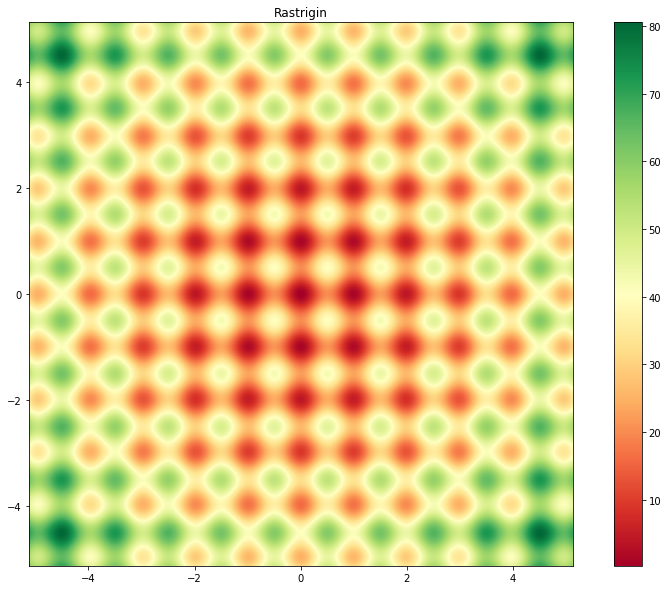

In [58]:
pixels = 200
extentMin = -5.12
extentMax = 5.12

X = np.linspace(extentMin, extentMax, pixels)     
Y = np.linspace(extentMin, extentMax, pixels)     
X, Y = np.meshgrid(X, Y) 

# Rastrigin
Z = rastrigin(X, Y)

fig, ax = plt.subplots()
fig.set_size_inches(15, 10)
im = ax.imshow(Z, interpolation='bilinear', cmap=cm.RdYlGn,
               origin='lower', extent=[extentMin, extentMax, extentMin, extentMax],
               vmax=Z.max(), vmin=Z.min())
points, = ax.plot([],[], 'go', markersize=10)
globalBest, = ax.plot([],[], 'ro', markersize=11)
colorbar(im)
title('Rastrigin')
#plt.show()
# ani = matplotlib.animation.FuncAnimation(fig, runPSO, frames=iterations)

# from IPython.display import HTML
# HTML(ani.to_jshtml())

In [60]:
# PSO particles init

# num particles
n = 20
xmin = ymin = extentMin
xmax = ymax = extentMax

pos = []
for i in range(n):
    rx = random.uniform(xmin, xmax)
    ry = random.uniform(ymin, ymax)
    pos.append(Point(rx, ry))
vel = [Point(0, 0) for i in range(n)]
localBestPos = [Point(0, 0) for i in range(n)]
localBestVal = [100000 for i in range(n)]

globalBestPos = Point(0, 0)
globalBestVal = 100000
inertia = 0.7298
cogPar = 1.49618
socPar = 1.49618
iterations = 50

def runPSO(t):
    global globalBestVal
    global globalBestPos
    r1 = random.uniform(0, 1)
    r2 = random.uniform(0, 1)
    for i in range(n):
        vel[i] = inertia * vel[i] + r1 * cogPar * (localBestPos[i] - pos[i]) + r2 * socPar * (globalBestPos - pos[i]) 
        pos[i] = pos[i] + vel[i]
        val = rastrigin(pos[i].x, pos[i].y)
        if val < localBestVal[i] :
            localBestVal[i] = val
            localBestPos[i] = pos[i]
        if val < globalBestVal :
            globalBestVal = val
            globalBestPos = pos[i]
    
    points.set_data([p.x for p in pos], [p.y for p in pos])
    globalBest.set_data([globalBestPos.x], [globalBestPos.y])

ani = matplotlib.animation.FuncAnimation(fig, runPSO, frames=iterations)

from IPython.display import HTML
HTML(ani.to_jshtml())